In [84]:
import numpy as np 
import pandas as pd 
from scipy import signal
import matplotlib.pyplot as plt 
import math
from sklearn import preprocessing
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import make_scorer, accuracy_score, confusion_matrix
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV

In [93]:
def data_visulization_accelerometer():
    # Taking all the 19 dataset to visualize the data
        for i in range(19):
            df = pd.read_csv('dataset_' + str(i + 1) + '.txt', sep=',', header=None)
            #taking all 13 activities
            for a in range (1,14):
                df_activity = df[df[24] == a].values
                plt.plot(df_activity[:, 0:3]) #Accelerometer sensor for wrist device
                plt.show()

In [92]:
def Data_visualization_gyro():
     # Taking all the 19 dataset to visualize the data
    for i in range(19):
            df = pd.read_csv('dataset_' + str(i + 1) + '.txt', sep=',', header=None)
            #taking all 13 activities
            for a in range (1,14):
                df_activity = df[df[24] == a].values
                plt.plot(df_activity[:, 3:6]) #Gyroscope sensor for wrist device
                plt.show()

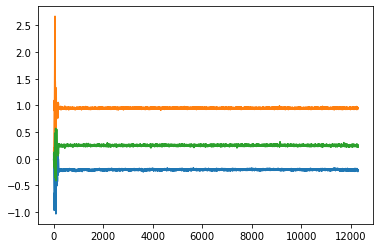

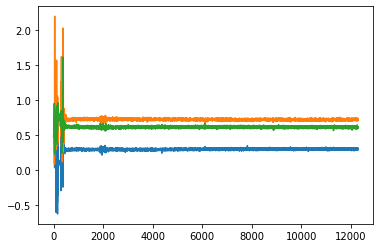

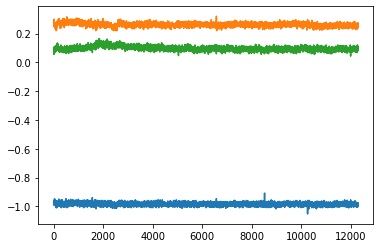

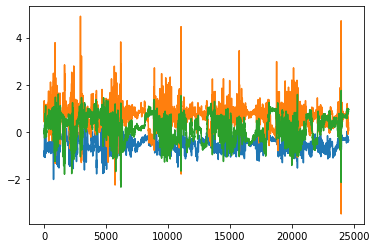

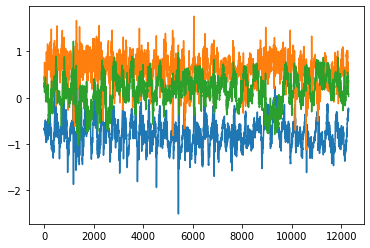

...

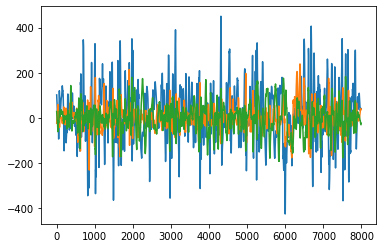

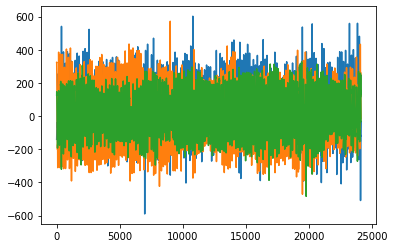

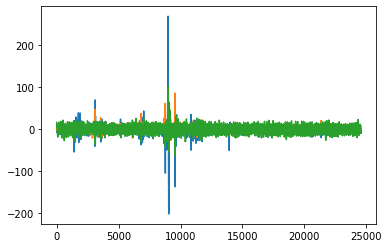

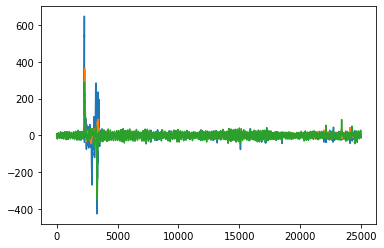

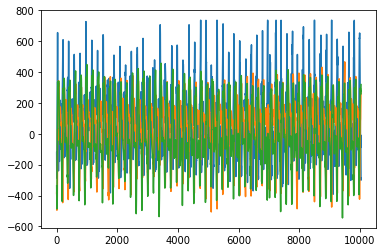

In [91]:
if __name__ == '__main__':
    main()

In [90]:
#Calling in the main function to visualize all the sensor data
def main():
    data_visulization_accelerometer()
    Data_visualization_gyro()
    

In [95]:
def noise_removing_accelerometer():
    for i in range(19):
        df = pd.read_csv('dataset_' + str(i + 1) + '.txt', sep=',', header=None)
    # Butterworth low-pass filter. You could try different parameters and other filters. 
        
        for a in range (1,14):
            df_activity = df[df[24] == a].values
            b, a = signal.butter(4, 0.04, 'low', analog=False)
            for i in range(3):
                df_activity[:,i] = signal.lfilter(b, a, df_activity[:, i])
            plt.plot(df_activity[:, 0:3])
            plt.show()

In [94]:
def noise_removing_Gyro():
    for i in range(19):
        df = pd.read_csv('dataset_' + str(i + 1) + '.txt', sep=',', header=None)
    # Butterworth low-pass filter. You could try different parameters and other filters. 
       
        for a in range (1,14):
            df_activity = df[df[24] == a].values
            b, a = signal.butter(4, 0.04, 'low', analog=False)
            df_activity[:,3:6] = signal.lfilter(b, a, df_activity[:, 3:6])
            plt.plot(df_activity[:, 3:6])
            plt.show()

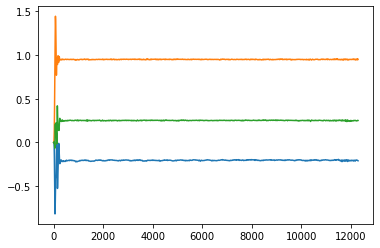

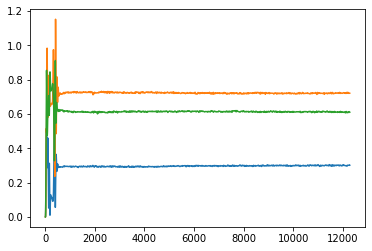

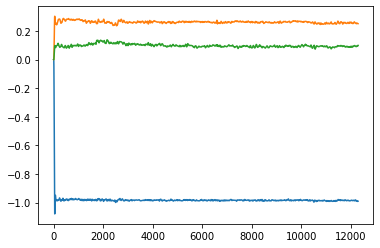

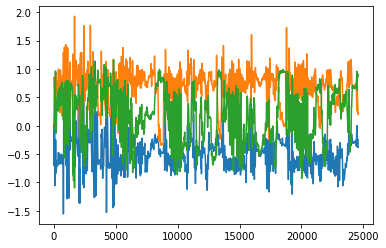

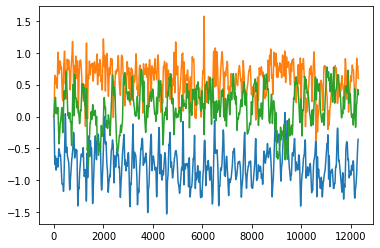

...

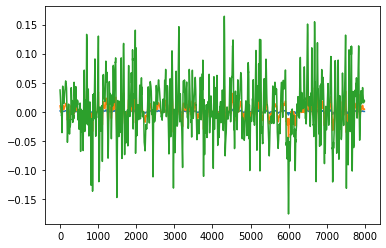

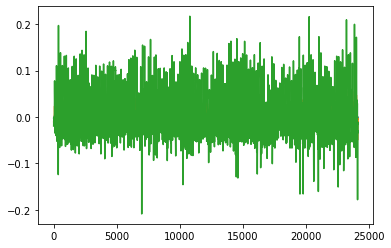

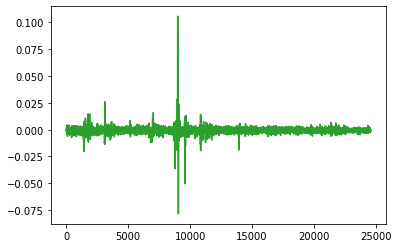

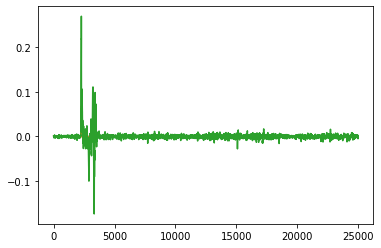

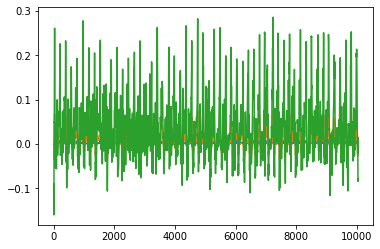

In [97]:
if __name__ == '__main__':
    main()

In [96]:
#calling in the main function to remove the noise from the raw sensor data
def main():
    noise_removing_accelerometer()
    noise_removing_Gyro()
    

In [103]:
# Extracting the features
def Feature_Extraction():
    # This is an empty array for training and testing model    
    training = np.empty(shape=(0, 100))
    testing = np.empty(shape=(0, 100))
    
    # Reading the first dataset and stored it in activity_data array
    df = pd.read_csv("dataset_1.txt",sep = ',',header=None)
    #  2 menas walking activity,This is the lebel
    activity_data = df[df[24]==2].values
    
    # deal with each dataset file, Reading each dataset from 2 to 19
    for i in range(1,19):
        df = pd.read_csv('dataset_' + str(i + 1) + '.txt', sep=',', header=None)
        print('deal with dataset ' + str(i + 1))
        # Appending all the data in activity data
        activity_data = np.append(activity_data,df[df[24]== 7].values, axis=0) # for walking
        # applying low pass filter
        b, a = signal.iirfilter(4, Wn=0.2, rp=5, rs=60, btype='lowpass', ftype='ellip')
        # storing it in all the columns of the activity data
        for j in range(24):
            activity_data[:, j] = signal.lfilter(b, a, activity_data[:, j])
    
    # Reading the length of the data
    datat_len = len(activity_data)
    # Calculating the training length taking .8 = 80%
    training_len = math.floor(datat_len * 0.8)
    # Storing it in training_data
    training_data = activity_data[:training_len, :]
    # store remaining in testing_data
    testing_data = activity_data[training_len:, :]
    
    # Calculating training and testing sample number
    training_sample_number = training_len // 8000 +1
    testing_sample_number = (datat_len - training_len) // 8000 + 1

    for i in range(training_sample_number):
        if i < training_sample_number-1:
            sample_data = training_data[8000*i:8000*(i+1),:]
        else: sample_data= training_data[8000*i:,:]
    
    
    # Step 5 : Preparing the taining sets 
    feature_sample = []
    feature_sample = np.array([feature_sample])
    # For Wrist 
    # Appending its value to the feature_sample
    for i in range(3):
        feature_sample= np.append(feature_sample,np.min(sample_data[:, i]))
        feature_sample = np.append(feature_sample,np.max(sample_data[:, i]))
        feature_sample= np.append(feature_sample,np.mean(sample_data[:, i]))

    feature_sample = np.array([feature_sample])
                
    # # For Chest sensors
    # Appending its value to the feature_sample
    for i in range(6,9):
        feature_sample= np.append(feature_sample,np.min(sample_data[:, i]))
        feature_sample = np.append(feature_sample,np.max(sample_data[:, i]))
        feature_sample= np.append(feature_sample,np.mean(sample_data[:, i]))

    # For Hips Sensors 
    # Appending its value to the feature_sample
    for i in range(12,15):
        feature_sample= np.append(feature_sample,np.min(sample_data[:, i]))
        feature_sample = np.append(feature_sample,np.max(sample_data[:, i]))
        feature_sample= np.append(feature_sample,np.mean(sample_data[:, i]))

    # For Ankle Sensors
    # Appending its value to the feature_sample
    for i in range(18,21):
        feature_sample= np.append(feature_sample,np.min(sample_data[:, i]))
        feature_sample = np.append(feature_sample,np.max(sample_data[:, i]))
        feature_sample= np.append(feature_sample,np.mean(sample_data[:, i]))

    feature_sample= np.append(feature_sample,sample_data[0, -1])
    feature_sample = np.array([feature_sample])
    training = np.append(training, feature_sample,axis=0)
    
    # Calculating the value for sample data
    sample_data = []
    for s in range(testing_sample_number):
        if s < training_sample_number - 1:
            sample_data = testing_data[8000*s:8000*(s + 1), :]
        else:
            sample_data = testing_data[8000*s:, :]

        
    """Testing data"""
        
    feature_sample = []
    feature_sample = np.array([feature_sample])
    # For Wrist 
    for i in range(3):
        feature_sample= np.append(feature_sample,np.min(sample_data[:, i]))
        feature_sample = np.append(feature_sample,np.max(sample_data[:, i]))
        feature_sample= np.append(feature_sample,np.mean(sample_data[:, i]))
            
    # For Chest sensors
    for i in range(6,9):
        feature_sample= np.append(feature_sample,np.min(sample_data[:, i]))
        feature_sample = np.append(feature_sample,np.max(sample_data[:, i]))
        feature_sample= np.append(feature_sample,np.mean(sample_data[:, i]))
    
    # For Hips Sensors 
    for i in range(12,15):
        feature_sample= np.append(feature_sample,np.min(sample_data[:, i]))
        feature_sample = np.append(feature_sample,np.max(sample_data[:, i]))
        feature_sample= np.append(feature_sample,np.mean(sample_data[:, i]))

    # For Ankle Sensors
    for i in range(18,21):
        feature_sample= np.append(feature_sample,np.min(sample_data[:, i]))
        feature_sample = np.append(feature_sample,np.max(sample_data[:, i]))
        feature_sample= np.append(feature_sample,np.mean(sample_data[:, i]))

    feature_sample= np.append(feature_sample,sample_data[0, -1])
    feature_sample = np.array([feature_sample])
    testing = np.append(training, feature_sample,axis=0)
    
    # Storing the values of training and testing dataset in a csv file
    df_training = pd.DataFrame(training)
    df_testing = pd.DataFrame(testing)
    df_training.to_csv('training_data.csv', index=None, header=None)
    df_testing.to_csv('testing_data.csv', index=None, header=None)

In [46]:
# Step 6 training the given model
def model_training_and_evaluation():

SyntaxError: unexpected EOF while parsing (<ipython-input-46-e4b5fd8a87c0>, line 2)

In [100]:
    df_training = pd.read_csv('training_data.csv', header=None)
    df_testing = pd.read_csv('testing_data.csv', header=None)

    y_train = df_training[36].values
    # Labels should start from 0 in sklearn
    y_train = y_train - 1
    df_training = df_training.drop([36], axis=1)
    X_train = df_training.values

    y_test = df_testing[36].values
    y_test = y_test - 1
    df_testing = df_testing.drop([36], axis=1)
    X_test = df_testing.values


In [101]:
knn = KNeighborsClassifier(n_neighbors=1)
knn.fit(X_train,y_train )


KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=1, p=2,
                     weights='uniform')

In [102]:
y_pred = knn.predict(X_test)
print('Accuracy: ', accuracy_score(y_test, y_pred))
# We could use confusion matrix to view the classification for each activity.
print(confusion_matrix(y_test, y_pred))


Accuracy:  1.0
[[2]]
